<a href="https://colab.research.google.com/github/srilamaiti/ml_works/blob/main/grayscale_testing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [11]:
import pandas as pd
import numpy as np
import random
import os

# tf and keras
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img, save_img
from keras import models
from keras import layers

# shap
#import shap

# plots and images
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import Image

#silence TF
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 


random.seed(2)
%matplotlib inline

# FILL IN CODE HERE #
#IMAGE_PATH = '/Users/cilin/Postdoc/teaching/cilin-coursework2/Live_Sessions/week06/NN_images/' # replace with your path
#LABEL_PATH = '/Users/cilin/Postdoc/teaching/cilin-coursework2/Live_Sessions/week06/NN_labels/' # replace with your path

In [3]:
# Required to read the data from Kaggle
from google.colab import drive
drive.mount('/content/gdrive')
os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/MyDrive/Kaggle"

Mounted at /content/gdrive


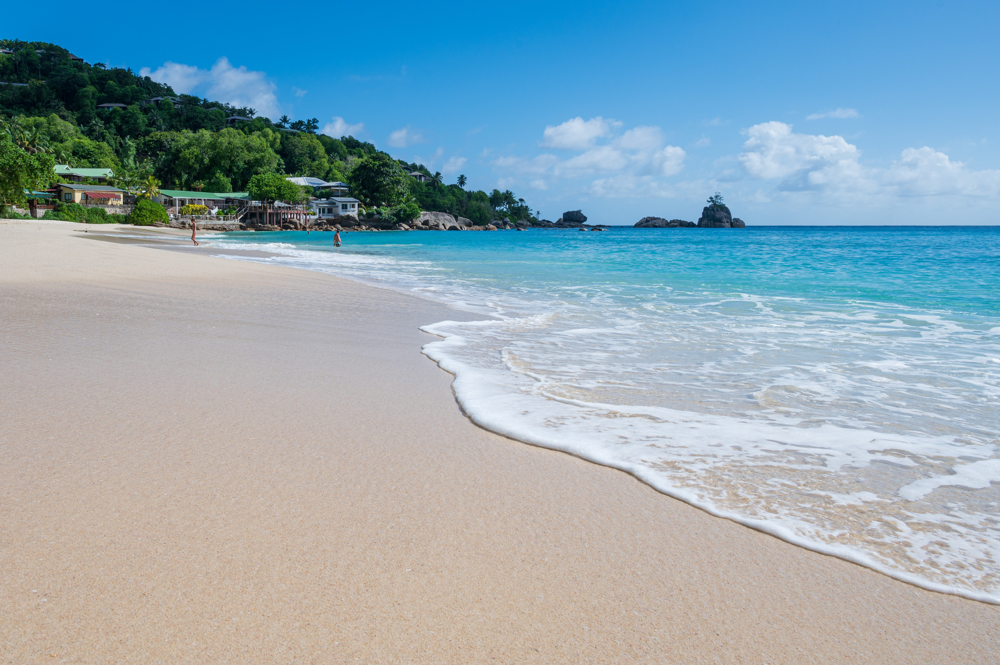

In [16]:
img = load_img('test.jpg')
img

In [17]:
img_array = img_to_array(img)
img_array

array([[[  0., 130., 208.],
        [  0., 130., 208.],
        [  0., 130., 208.],
        ...,
        [ 81., 159., 221.],
        [ 80., 158., 220.],
        [ 80., 159., 218.]],

       [[  0., 131., 209.],
        [  0., 131., 209.],
        [  0., 131., 209.],
        ...,
        [ 80., 158., 220.],
        [ 80., 158., 220.],
        [ 80., 159., 218.]],

       [[  0., 131., 209.],
        [  0., 131., 209.],
        [  0., 131., 209.],
        ...,
        [ 80., 158., 220.],
        [ 80., 158., 220.],
        [ 79., 158., 217.]],

       ...,

       [[203., 184., 154.],
        [202., 183., 153.],
        [201., 180., 151.],
        ...,
        [174., 160., 157.],
        [178., 164., 164.],
        [171., 164., 156.]],

       [[206., 187., 157.],
        [204., 185., 155.],
        [202., 183., 153.],
        ...,
        [171., 157., 154.],
        [180., 166., 165.],
        [175., 168., 160.]],

       [[202., 188., 161.],
        [202., 186., 160.],
        [202., 1

In [15]:
img_array.shape

(3153, 4737, 1)

In [20]:
# load image as as grayscale
img_gs = load_img('test.jpg', grayscale=True)
# convert image to a numpy array
img_array_gs = img_to_array(img_gs)
# save the image with a new filename
save_img('test1.jpg', img_array_gs)
# load the image to confirm it was saved correctly
img = load_img('test1.jpg')
print(type(img))
print(img.format)
print(img.mode)
print(img.size)
img.show()

/usr/local/lib/python3.7/dist-packages/keras/utils/image_utils.py:382: UserWarning: grayscale is deprecated. Please use color_mode = "grayscale"
  warnings.warn('grayscale is deprecated. Please use '


<class 'PIL.Image.Image'>
None
RGB
(4737, 3153)


In [23]:
img_gs.getbands(), img.getbands()

(('L',), ('R', 'G', 'B'))

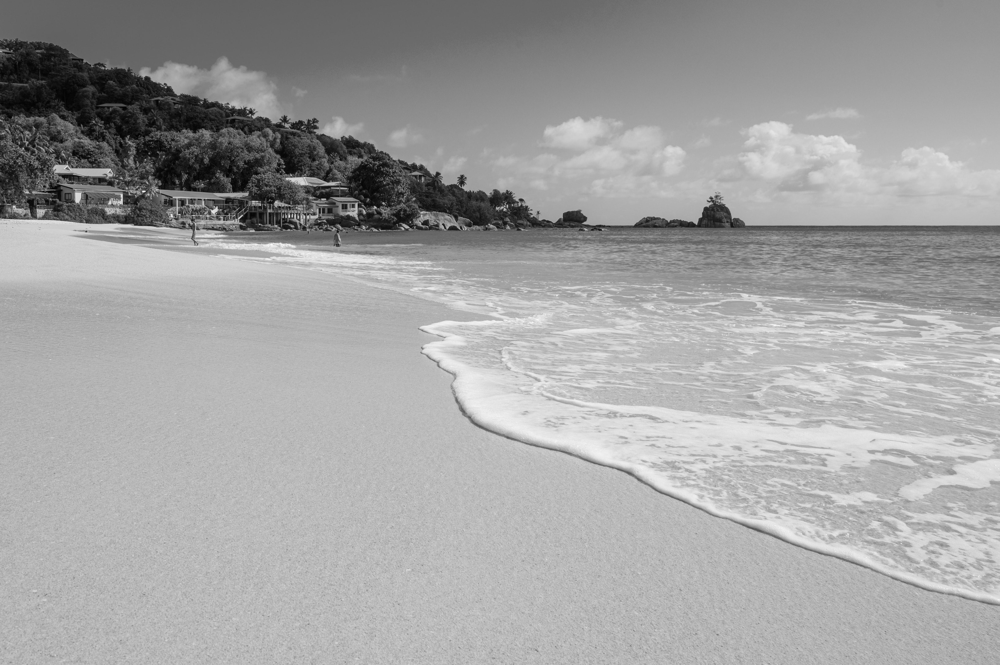

In [14]:
img

In [8]:
type(img_array), type(img)

(numpy.ndarray, PIL.JpegImagePlugin.JpegImageFile)

In [19]:
img_array.shape, img_array_gs.shape

((3153, 4737, 3), (3153, 4737, 1))

In [ ]:
grayscale_img_array = tf.image.rgb_to_grayscale(img_array)
grayscale_img_array.shape, type(grayscale_img_array)

(TensorShape([1736, 2416, 1]), tensorflow.python.framework.ops.EagerTensor)

In [ ]:
grayscale_img_array[0]

<tf.Tensor: shape=(2416, 1), dtype=float32, numpy=
array([[1.9998001],
       [1.9998001],
       [1.9998001],
       ...,
       [1.7117001],
       [1.7117001],
       [1.7117001]], dtype=float32)>

In [ ]:
grayscale_img_array_scaled_down = grayscale_img_array / 255
grayscale_img_array_scaled_down.shape, type(grayscale_img_array_scaled_down)

(TensorShape([1736, 2416, 1]), tensorflow.python.framework.ops.EagerTensor)

In [ ]:
grayscale_img_array_scaled_down[0]

<tf.Tensor: shape=(2416, 1), dtype=float32, numpy=
array([[0.00784235],
       [0.00784235],
       [0.00784235],
       ...,
       [0.00671255],
       [0.00671255],
       [0.00671255]], dtype=float32)>